In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import plotly.express as px
import folium as fo
from folium.plugins import HeatMap

In [2]:
f=os.listdir('/Users/mac/Desktop/DataScience/Uber Analysis/uber-pickups-in-new-york-city')

In [3]:
f1=f[-7:] #to access last 7 datasets

In [4]:
f1

['other-Federal_02216.csv',
 'uber-raw-data-jun14.csv',
 'other-Carmel_B00256.csv',
 'other-Diplo_B01196.csv',
 'other-Dial7_B00887.csv',
 'uber-raw-data-may14.csv',
 'other-Prestige_B01338.csv']

#to remove a single dataset from file we use .remove() 

In [5]:
f1.remove('uber-raw-data-may14.csv')

In [6]:
f1

['other-Federal_02216.csv',
 'uber-raw-data-jun14.csv',
 'other-Carmel_B00256.csv',
 'other-Diplo_B01196.csv',
 'other-Dial7_B00887.csv',
 'other-Prestige_B01338.csv']

In [7]:
files=['uber-raw-data-apr14.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [8]:
path= '/Users/mac/Desktop/DataScience/Uber Analysis/uber-pickups-in-new-york-city'
final=pd.DataFrame()
for file in files:
    df=pd.read_csv(path+"/"+file)
    final=pd.concat([final,df])

In [9]:
final.head()

,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512


In [10]:
final.shape

(4534327, 4)

####  Data Preparation¶

##### Lat : The latitude of the Uber pickup

##### Lon : The longitude of the Uber pickup

##### Base : The TLC base company code affiliated with the Uber pickup

 The globe is split into an imaginary 360 sections from both top to bottom (north to south) and 180 sections from side to side (west to east). The sections running from top to bottom on a globe are called longitude, and the sections running from side to side on a globe are called latitude.

Latitude is the measurement of distance north or south of the Equator.

Every location on earth has a global address. Because the address is in numbers, people can communicate about location no matter what language they might speak. A global address is given as two numbers called coordinates. The two numbers are a location's latitude number and its longitude number ("Lat/Long").

In [11]:
df=final.copy()

In [12]:
df.head()

,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512


In [13]:
df.dtypes

Date/Time     object
Lat          float64
Lon          float64
Base          object
dtype: object

In [14]:
#Since date/time is in object so we will firstly convert this col into time dt
df['Date/Time'] = pd.to_datetime(df['Date/Time'], format="%m/%d/%Y %H:%M:%S")

In [15]:
df.dtypes

Date/Time    datetime64[ns]
Lat                 float64
Lon                 float64
Base                 object
dtype: object

In [16]:
df.head()

,Date/Time,Lat,Lon,Base
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512


In [17]:
df['Weekday']=df['Date/Time'].dt.day_name() #wed,tuesday,monday etc
df['Day']=df['Date/Time'].dt.day
df['Minutes']=df['Date/Time'].dt.minute
df['Month']=df['Date/Time'].dt.month
df['Hour']=df['Date/Time'].dt.hour

In [18]:
df.head()

,Date/Time,Lat,Lon,Base,Weekday,Day,Minutes,Month,Hour
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,Tuesday,1,11,4,0
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,Tuesday,1,17,4,0
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,Tuesday,1,21,4,0
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,Tuesday,1,28,4,0
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,Tuesday,1,33,4,0


## 1. Analysis of journey by week-days

In [19]:
weekday=df['Weekday'].value_counts()

In [20]:
px.bar(df,x=weekday.index,y=weekday)

Rush is highest on Thursday in New York, Hence high sales on this day.

# 2. Analysis of journey by hour

In [21]:
hour=df['Hour'].value_counts()

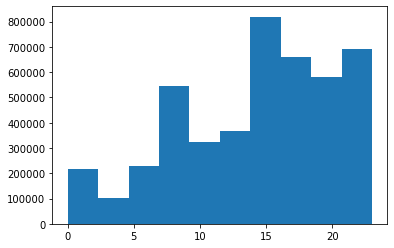

In [22]:
plt.hist(df['Hour']);

Finding for each and every month

In [23]:
df['Month'].unique()

array([4, 8, 7, 6, 5, 9])

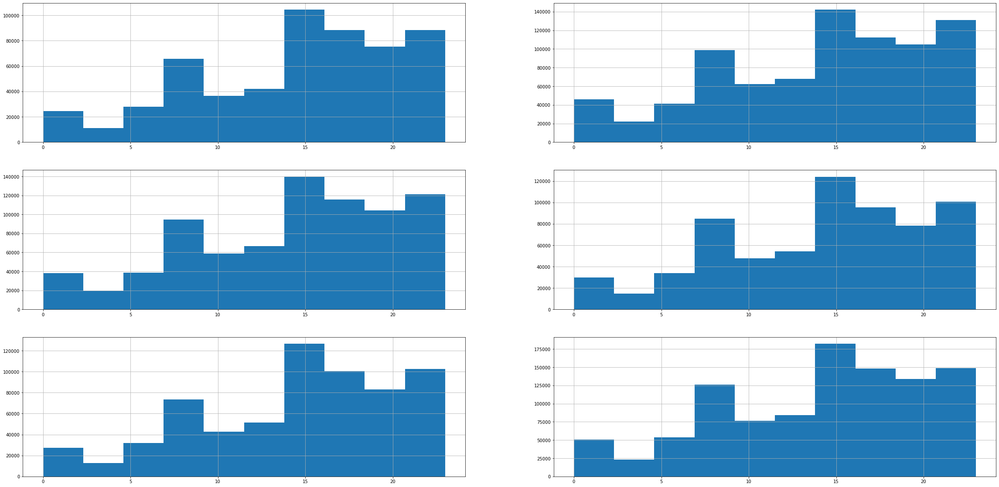

In [24]:
plt.figure(figsize=(40,20))
for index,month in enumerate(df['Month'].unique()):
    plt.subplot(3,2,index+1)
    df[df['Month']==month]['Hour'].hist()

We analyse that in each and every month the peak time is around the evening time

# 3. Analysing which month has max rides

In [25]:
#First way to do
month=df.groupby(['Month'])['Hour'].count()
month

Month
4     564516
5     652435
6     663844
7     796121
8     829275
9    1028136
Name: Hour, dtype: int64

2nd way to do...

month=df['Month'].value_counts()

month


In [26]:
px.bar(df,x=month.index,y=month)

In September the rides were highest.

# 4. Analysis of journey of each day.

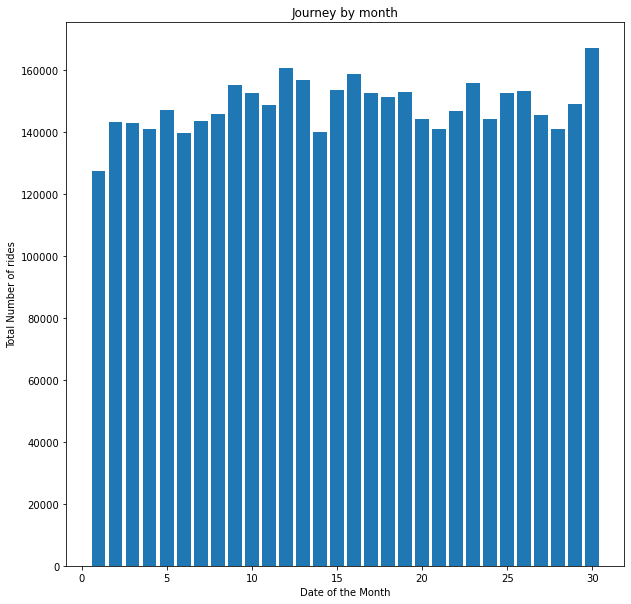

In [27]:
plt.figure(figsize=(10,10))
plt.hist(df['Day'],bins=30,rwidth=0.8,range=(0.5,30.5)) #30.5 coz we have mentioned bins as 30
plt.xlabel('Date of the Month')
plt.ylabel('Total Number of rides')
plt.title('Journey by month');

On each and every month,on 30th the number is highest.

But we can check if the above graph ploted is right or not using dist plot from seaborn library.

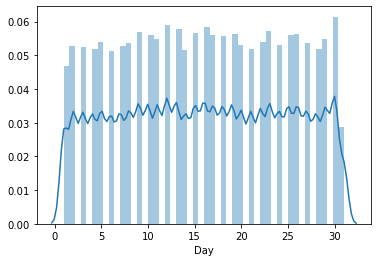

In [28]:
sns.distplot(df['Day']);

# 5. Analyse total rides month-wise

In [29]:
months=df['Month'].unique()

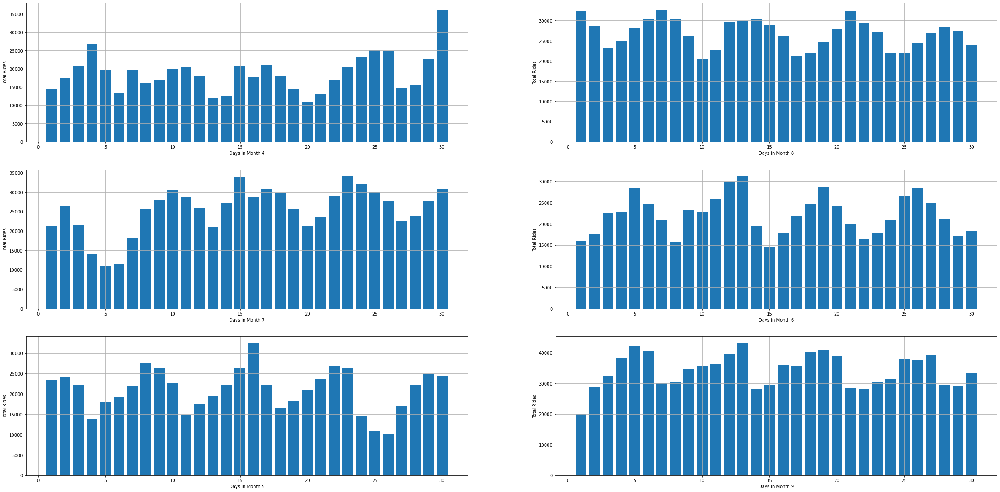

In [30]:
plt.figure(figsize=(40,20))
for index,month in enumerate(months):
    plt.subplot(3,2,index+1)
    df[df['Month']==month]['Day'].hist(bins=30,rwidth=0.8,range=(0.5,30.5))
    plt.xlabel('Days in Month {}'.format(month))
    plt.ylabel('Total Rides')

#To check the above result

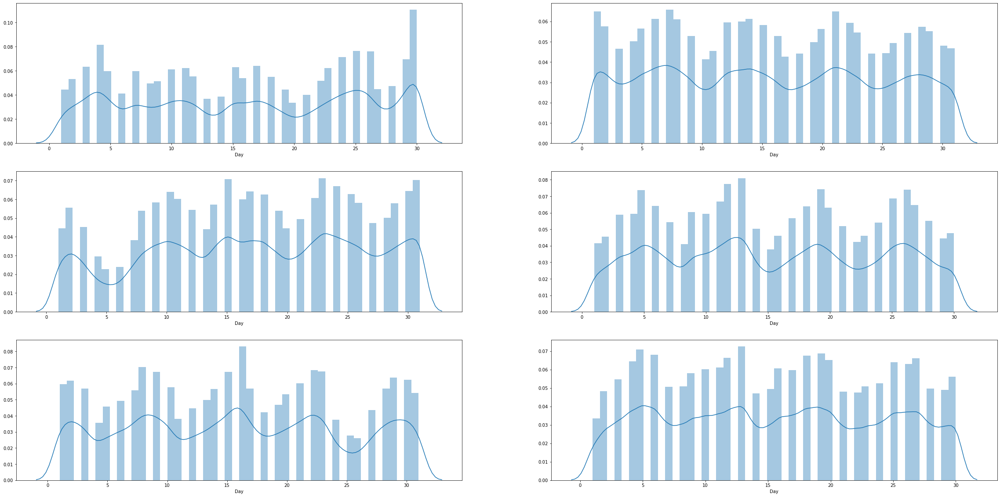

In [31]:
plt.figure(figsize=(40,20))
for index,month in enumerate(months):
    plt.subplot(3,2,index+1)
    sns.distplot(df[df['Month']==month]['Day'])

# 6. Analyse the rush hours in different places (Lat)

Text(0.5, 1.0, 'Hours of day vs Latitude of Passengers')

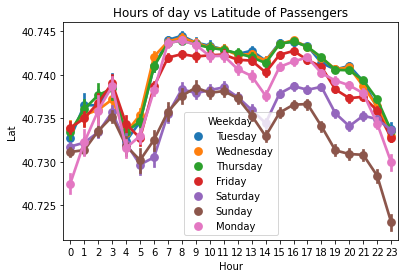

In [32]:
ax=sns.pointplot(x='Hour',y='Lat',data=df,hue='Weekday')
ax.set_title('Hours of day vs Latitude of Passengers')

# 7. Analyse which base number gets popular by month name 

In [33]:
base=df.groupby(['Base','Month'])['Date/Time'].count().reset_index()
base

,Base,Month,Date/Time
0,B02512,4,35536
1,B02512,5,36765
2,B02512,6,32509
3,B02512,7,35021
4,B02512,8,31472
5,B02512,9,34370
6,B02598,4,183263
7,B02598,5,260549
8,B02598,6,242975
9,B02598,7,245597


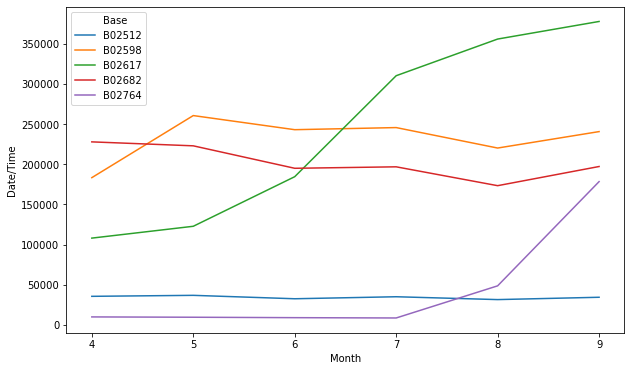

In [34]:
plt.figure(figsize=(10,6))
sns.lineplot(x='Month',y='Date/Time',hue='Base',data=base);

# 8. Perform Cross Analysis

### A. Heatmap by Hour and Weekday 

In [35]:
def count_rows(rows):
    return len(rows)

In [36]:
# For this we first have to group the data using hour and weekday.
df.groupby(['Weekday','Hour']).apply(count_rows)

Weekday    Hour
Friday     0       13716
           1        8163
           2        5350
           3        6930
           4        8806
                   ...  
Wednesday  19      47017
           20      47772
           21      44553
           22      32868
           23      18146
Length: 168, dtype: int64

In [37]:
by_cross=df.groupby(['Weekday','Hour'])['Hour'].count()

In [38]:
by_cross

Weekday    Hour
Friday     0       13716
           1        8163
           2        5350
           3        6930
           4        8806
                   ...  
Wednesday  19      47017
           20      47772
           21      44553
           22      32868
           23      18146
Name: Hour, Length: 168, dtype: int64

creating pivot table, we use table_name.unstack()

In [39]:
pivot=by_cross.unstack()
pivot

Hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
Weekday,,,,,,,,,,,,,,,,,,,,,
Friday,13716,8163,5350,6930,8806,13450,23412,32061,31509,25230,...,36206,43673,48169,51961,54762,49595,43542,48323,49409,41260
Monday,6436,3737,2938,6232,9640,15032,23746,31159,29265,22197,...,28157,32744,38770,42023,37000,34159,32849,28925,20158,11811
Saturday,27633,19189,12710,9542,6846,7084,8579,11014,14411,17669,...,31418,38769,43512,42844,45883,41098,38714,43826,47951,43174
Sunday,32877,23015,15436,10597,6374,6169,6596,8728,12128,16401,...,28151,31112,33038,31521,28291,25948,25076,23967,19566,12166
Thursday,9293,5290,3719,5637,8505,14169,27065,37038,35431,27812,...,36699,44442,50560,56704,55825,51907,51990,51953,44194,27764
Tuesday,6237,3509,2571,4494,7548,14241,26872,36599,33934,25023,...,34846,41338,48667,55500,50186,44789,44661,39913,27712,14869
Wednesday,7644,4324,3141,4855,7511,13794,26943,36495,33826,25635,...,35148,43388,50684,55637,52732,47017,47772,44553,32868,18146


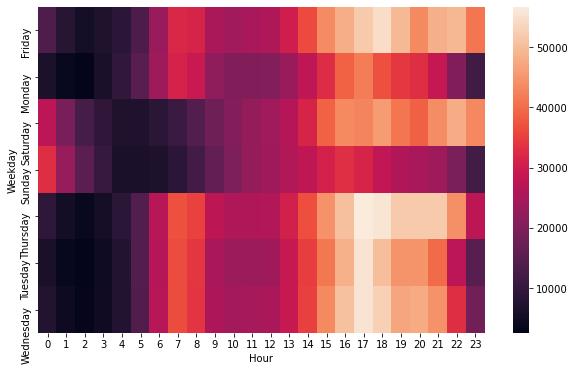

In [40]:
plt.figure(figsize=(10,6))
sns.heatmap(pivot);

In [41]:
def heatmap(col1,col2):
    by_cross=df.groupby([col1,col2])['Hour'].count()
    pivot=by_cross.unstack()
    plt.figure(figsize=(10,6))
    ax=sns.heatmap(pivot)
    return ax

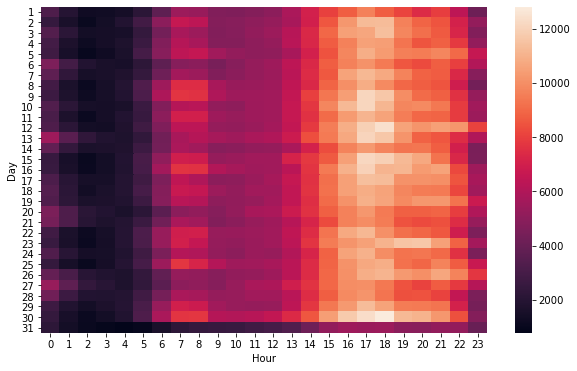

In [42]:
heatmap('Day','Hour');

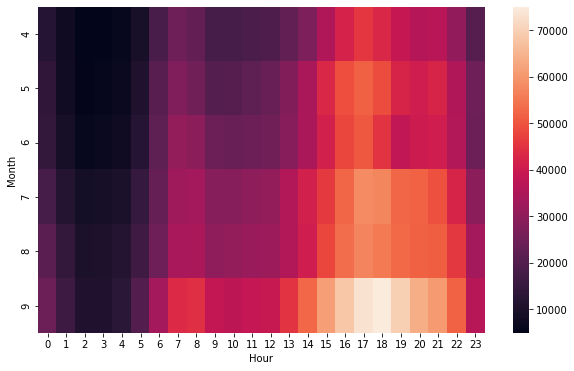

In [43]:
heatmap('Month','Hour');

# 9. Analysis of Location data points.

In [44]:
df.head() 

,Date/Time,Lat,Lon,Base,Weekday,Day,Minutes,Month,Hour
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,Tuesday,1,11,4,0
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,Tuesday,1,17,4,0
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,Tuesday,1,21,4,0
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,Tuesday,1,28,4,0
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,Tuesday,1,33,4,0


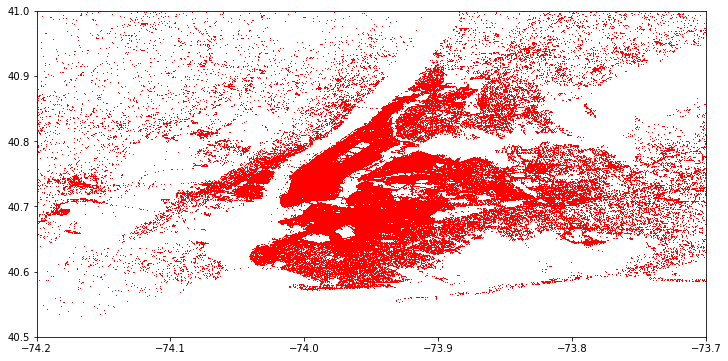

In [45]:
plt.figure(figsize=(12,6))
plt.plot(df['Lon'],df['Lat'],'r+',ms=0.5) #ms=marker size
plt.xlim(-74.2,-73.7)
plt.ylim(40.5,41);

From this we get that there is a rush in the region which has lat and long bw -74.1 to -73.8. To know the perfect stuffs we can always do spatial analysis.

# 10. Perform Spatial Analysis using Heatmap to get clear cut of Rush.

In [46]:
 df_weekday=df[df['Weekday']=='Sunday']

In [47]:
df_weekday.shape

(490180, 9)

In [48]:
rush=df_weekday.groupby(['Lat','Lon'])['Weekday'].count().reset_index()

In [49]:
rush.columns=['Lat','Lon','No. of Trips']

In [50]:
rush.head()

,Lat,Lon,No. of Trips
0,39.9374,-74.0722,1
1,39.9378,-74.0721,1
2,39.9384,-74.0742,1
3,39.9385,-74.0734,1
4,39.9415,-74.0736,1


In [51]:
basemap=fo.Map() #forming a map

In [52]:
HeatMap(rush,zoom=20,radius=15).add_to(basemap)
basemap

# 10. Automate your Analysis

In [53]:
def plot(df,day):
    basemap=fo.Map()
    df_weekday=df[df['Weekday']==day]
    rush=df_weekday.groupby(['Lat','Lon'])['Weekday'].count().reset_index()
    HeatMap(rush,radius=15,zoom=20).add_to(basemap)
    return basemap

In [54]:
plot(df,'Monday')

# DATA PREPARATION FOR PICKUP DATA

In [55]:
uber_15=pd.read_csv('/Users/mac/Desktop/DataScience/Uber Analysis/uber-pickups-in-new-york-city/uber-raw-data-janjune-15.csv')

In [56]:
uber_15.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID
0,B02617,2015-05-17 09:47:00,B02617,141
1,B02617,2015-05-17 09:47:00,B02617,65
2,B02617,2015-05-17 09:47:00,B02617,100
3,B02617,2015-05-17 09:47:00,B02774,80
4,B02617,2015-05-17 09:47:00,B02617,90


In [57]:
uber_15.dtypes

Dispatching_base_num    object
Pickup_date             object
Affiliated_base_num     object
locationID               int64
dtype: object

In [58]:
uber_15['Pickup_date']=pd.to_datetime(uber_15['Pickup_date'])

In [59]:
uber_15.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID
0,B02617,2015-05-17 09:47:00,B02617,141
1,B02617,2015-05-17 09:47:00,B02617,65
2,B02617,2015-05-17 09:47:00,B02617,100
3,B02617,2015-05-17 09:47:00,B02774,80
4,B02617,2015-05-17 09:47:00,B02617,90


In [60]:
uber_15.dtypes

Dispatching_base_num            object
Pickup_date             datetime64[ns]
Affiliated_base_num             object
locationID                       int64
dtype: object

In [61]:
uber_15['Weekday']=uber_15['Pickup_date'].dt.day_name()
uber_15['Day']=uber_15['Pickup_date'].dt.day
uber_15['Month']=uber_15['Pickup_date'].dt.month
uber_15['Minute']=uber_15['Pickup_date'].dt.minute
uber_15['Hour']=uber_15['Pickup_date'].dt.hour

In [62]:
uber_15.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID,Weekday,Day,Month,Minute,Hour
0,B02617,2015-05-17 09:47:00,B02617,141,Sunday,17,5,47,9
1,B02617,2015-05-17 09:47:00,B02617,65,Sunday,17,5,47,9
2,B02617,2015-05-17 09:47:00,B02617,100,Sunday,17,5,47,9
3,B02617,2015-05-17 09:47:00,B02774,80,Sunday,17,5,47,9
4,B02617,2015-05-17 09:47:00,B02617,90,Sunday,17,5,47,9


# 11. Uber pickups by the month in NYC 

In [63]:
month_pickup=uber_15['Month'].value_counts()

In [64]:
plt.figure(figsize=(10,8))
px.bar(uber_15,x=month_pickup.index,y=month_pickup)

<Figure size 720x576 with 0 Axes>

June has the highest pickups. But we also infer that the pickups have increased as each month pases by.

# 12. Analysing rush in NYC.

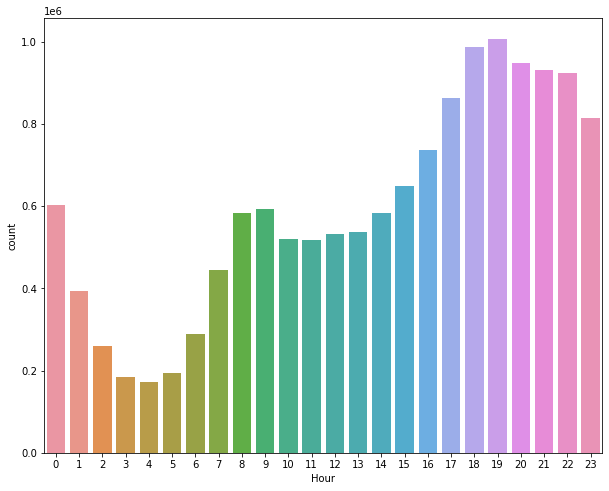

In [65]:
plt.figure(figsize=(10,8))
sns.countplot(uber_15['Hour']);

Significantly more demand during evening.

# 13. Analysing in depth analysis of rush in NYC day and hour wise

In [66]:
summary=uber_15.groupby(['Weekday','Hour'])['Pickup_date'].count().reset_index()
summary.columns=['Weekday','Hour','Count']
summary.head()

,Weekday,Hour,Count
0,Friday,0,85939
1,Friday,1,46616
2,Friday,2,28102
3,Friday,3,19518
4,Friday,4,23575


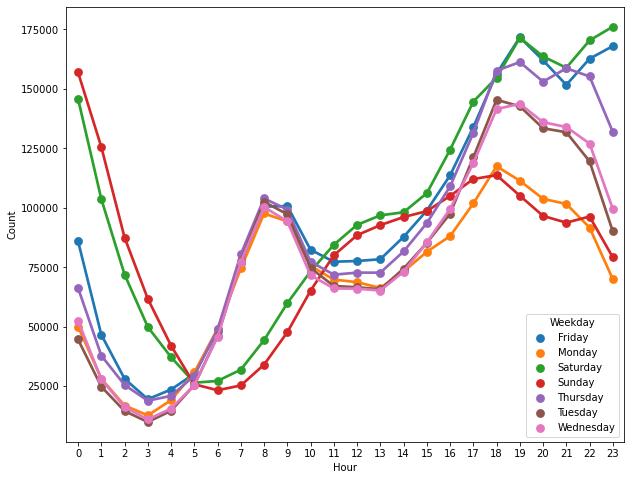

In [67]:
plt.figure(figsize=(10,8))
sns.pointplot(x='Hour',y='Count',hue='Weekday',data=summary);

# 14. Analyse which base number has most active vehicles

In [68]:
uber_foil=pd.read_csv('/Users/mac/Desktop/DataScience/Uber Analysis/uber-pickups-in-new-york-city/Uber-Jan-Feb-FOIL.csv')

In [69]:
uber_foil.head()

,dispatching_base_number,date,active_vehicles,trips
0,B02512,1/1/2015,190,1132
1,B02765,1/1/2015,225,1765
2,B02764,1/1/2015,3427,29421
3,B02682,1/1/2015,945,7679
4,B02617,1/1/2015,1228,9537


In [70]:
uber_foil.dtypes

dispatching_base_number    object
date                       object
active_vehicles             int64
trips                       int64
dtype: object

In [71]:
uber_foil['dispatching_base_number'].unique()

array(['B02512', 'B02765', 'B02764', 'B02682', 'B02617', 'B02598'],
      dtype=object)

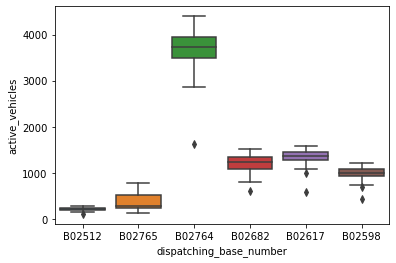

In [72]:
sns.boxplot(x='dispatching_base_number',y='active_vehicles',data=uber_foil);

# 15. Analysing which base number has most trips

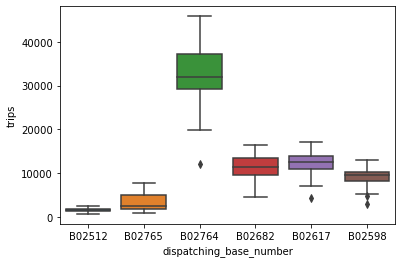

In [97]:
sns.boxplot(x='dispatching_base_number',y='trips',data=uber_foil);

# 16. How average trips per vehicle inc/decreases with dates with each of base number

In [99]:
uber_foil['Trips/vehicle']=uber_foil['trips']/uber_foil['active_vehicles']

In [100]:
uber_foil.head()

,dispatching_base_number,date,active_vehicles,trips,Trips/vehicle
0,B02512,1/1/2015,190,1132,5.957895
1,B02765,1/1/2015,225,1765,7.844444
2,B02764,1/1/2015,3427,29421,8.585060
3,B02682,1/1/2015,945,7679,8.125926
4,B02617,1/1/2015,1228,9537,7.766287


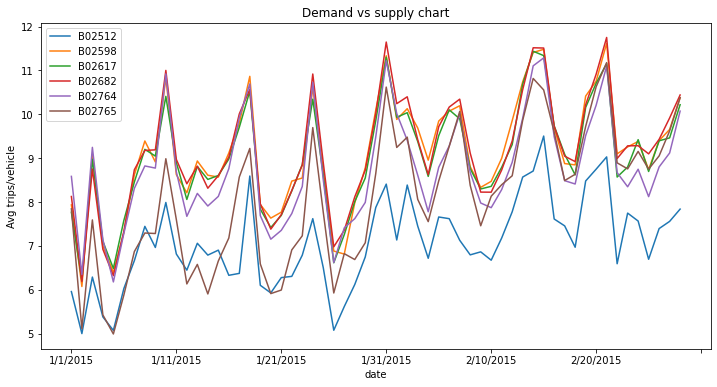

In [103]:
plt.figure(figsize=(12,6))
uber_foil.set_index('date').groupby(['dispatching_base_number'])['Trips/vehicle'].plot()
plt.ylabel('Avg trips/vehicle')
plt.title('Demand vs supply chart')
plt.legend();